<a href="https://colab.research.google.com/github/04-AhmadThariqRamadhan/PCVK_Genap_2023/blob/main/Week3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#D. PRAKTIKUM

In [3]:
from google.colab import drive

# Accessing My Google Drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [12]:
import cv2 as cv
from google.colab.patches import cv2_imshow
from skimage import io
import matplotlib.pyplot as plt
import numpy as np
img = cv.imread('/content/drive/MyDrive/images/rog.jpg')
img_rgb = cv.cvtColor(img,cv.COLOR_BGR2RGB)

#Transformasi Linier Brightness

 Mengubah tingkat kecerahan citra 
----------------------------------
Masukkan nilai kecerahan: 50


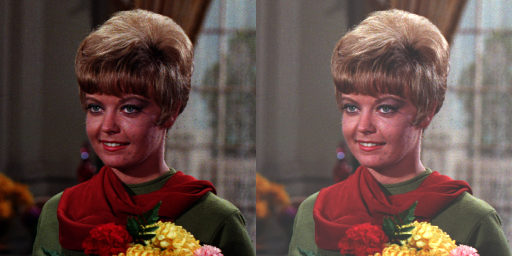

In [5]:
print(' Mengubah tingkat kecerahan citra ')
print('----------------------------------')
try:
  brightness = int(input('Masukkan nilai kecerahan: '))
except ValueError:
  print('Error, not a number')
original = cv.imread('/content/drive/MyDrive/images/female.tiff')

brightness_image = np.zeros(original.shape, original.dtype)
#akses per piksel
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      brightness_image[y,x,c] = np.clip(original[y,x,c] + brightness, 0, 255)

#cara simple tanpa for loop
#brightness_image = cv.convertScaleAbs(original, beta=brightness)

final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

#TUGAS PRAKTIKUM2

1. Implementasikan inverse citra pada Google Colaboratory menggunakan formula yang 
terdapat pada bagian Ulasan Teori, sehingga menghasilkan keluaran seperti berikut: 

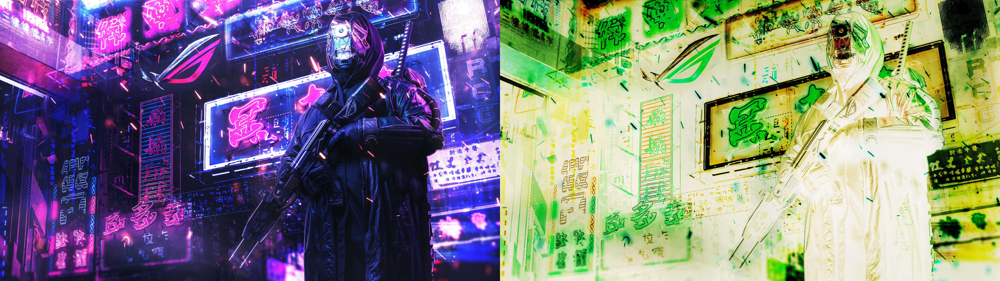

In [6]:
rog = cv.imread('/content/drive/MyDrive/images/rog.jpg')

rog2 = 255 - rog
final_frame = cv.hconcat((rog, rog2))
cv2_imshow(final_frame)

2. Implementasikan transformasi contrast pada Google Colaboratory menggunakan 
formula yang terdapat pada bagian Ulasan Teori untuk kontras, sehingga 
menghasilkan keluaran seperti berikut:

 Mengubah tingkat kecerahan citra 
----------------------------------
Masukkan nilai kecerahan [-255 - 255]: 55
Masukkan kontras [1.0 - 3.0]: 3


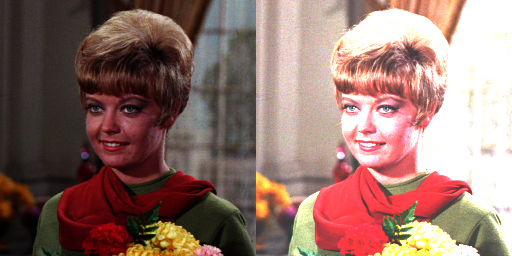

In [7]:
print(' Mengubah tingkat kecerahan citra ')
print('----------------------------------')
try:
  brightness = int(input('Masukkan nilai kecerahan [-255 - 255]: '))
  contrast = float(input('Masukkan kontras [1.0 - 3.0]: '))
except ValueError:
  print('Error, not a number')
original = cv.imread('/content/drive/MyDrive/images/female.tiff')

brightness_image = np.zeros(original.shape, original.dtype)
#akses per piksel
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      brightness_image[y,x,c] = np.clip(contrast*original[y,x,c] + brightness, 0, 255)

#cara simple tanpa for loop
#brightness_image = cv.convertScaleAbs(original, beta=brightness)

final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

3. Implementasikan transformasi logarithmic brightness pada Google Colaboratory 
menggunakan formula yang terdapat pada bagian Ulasan Teori untuk transformasi 
log, sehingga menghasilkan keluaran seperti berikut:

 Mengubah tingkat kecerahan citra dengan Transformasi Log 
----------------------------------------------------------
Masukan Nilai Kecerahan: 55


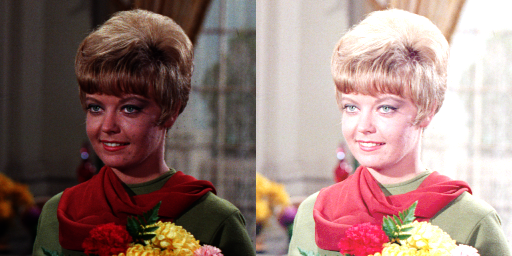

In [8]:
print(' Mengubah tingkat kecerahan citra dengan Transformasi Log ')
print('----------------------------------------------------------')

try:
  brightness = int(input('Masukan Nilai Kecerahan: '))
except ValueError:
  input('Error, not a number')

original = cv.imread('/content/drive/MyDrive/images/female.tiff')
brightness_image = np.zeros(original.shape, original.dtype)

for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      brightness_image[y,x,c] = np.clip(brightness * (np.log(1 + original[y,x,c])), 0 , 255)

final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

4. Implementasikan transformasi grayscale menggunakan metode averaging, lightness, 
dan luminance pada Google Colaboratory menggunakan formula yang terdapat pada 
bagian Ulasan Teori, sehingga menghasilkan keluaran seperti berikut:

a. Averaging

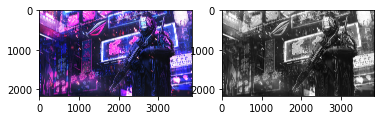

In [16]:
original = cv.imread('/content/drive/MyDrive/images/rog.jpg')
original[:] = original.mean(axis=-1, keepdims=10)
fig, ax = plt.subplots(1,2)
ax[0].imshow(img_rgb)
ax[1].imshow(original)

b. Lightness

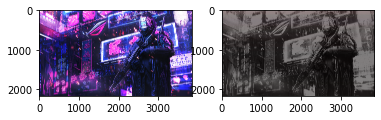

In [13]:
original = cv.imread('/content/drive/MyDrive/images/rog.jpg')
original[:] = np.max(original,axis=-1, keepdims=100)/2 + np.min(original,axis=-2, keepdims=100)/3
fig, ax = plt.subplots(1,2)
ax[0].imshow(img_rgb)
ax[1].imshow(original)

c. Luminance

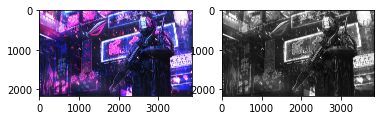

In [14]:
original = cv.imread('/content/drive/MyDrive/images/rog.jpg')
R, G, B = original[:,:,0], original[:,:,1], original[:,:,2]
gray_img = (0.21 * R) + (0.72 * G) + (0.07 * B)
fig, ax = plt.subplots(1,2)
ax[0].imshow(img_rgb)
ax[1].imshow(gray_img, cmap='gray')

5. Tampilkanlah warna tertentu pada citra, dan ubah warna lain menjadi grayscale. Misal, 
tampilkan warna biru pada citra masukan dan ubah bagian lain yang tidak berwarna 
biru menjadi grayscale seperti pada contoh berikut:

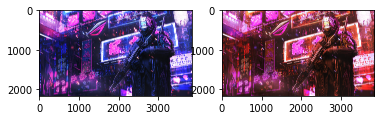

In [17]:
original = cv.imread('/content/drive/MyDrive/images/rog.jpg')
ret, mask = cv.threshold(original[:,:,2], 188, 255, cv.THRESH_BINARY)
mask3 = np.zeros_like(original)
mask3[:,:,0] = mask
mask3[:,:,1] = mask
mask3[:,:,2] = mask

red = cv.bitwise_and(img_rgb, mask3)

gray = cv.cvtColor(original, cv.COLOR_BGR2GRAY)
img2 = cv.cvtColor(gray, cv.COLOR_GRAY2BGR)
gray = cv.bitwise_and(original, 255 - mask3)
out = gray + red
fig, ax = plt.subplots(1,2)
ax[0].imshow(img_rgb)
ax[1].imshow(out, cmap='gray')